<a href="https://colab.research.google.com/github/bhogasena/TelecomChurn_Prediction/blob/main/TelecomChurn_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Telecom Churn Case Study Hackathon

The main goal of the case study is to build ML models to predict churn. The predictive model that you’re going to build will the following purposes:


1.   It will be used to predict whether a high-value customer will churn or not, in near future (i.e. churn phase). By knowing this, the company can take action steps such as providing special plans, discounts on recharge etc.
2.   It will be used to identify important variables that are strong predictors of churn. These variables may also indicate why customers choose to switch to other networks.

3. Even though overall accuracy will be your primary evaluation metric, you should also mention other metrics like precision, recall, etc. for the different models that can be used for evaluation purposes based on different business objectives. For example, in this problem statement, one business goal can be to build an ML model that identifies customers who'll definitely churn with more accuracy as compared to the ones who'll not churn. Make sure you mention which metric can be used in such scenarios.

4. Recommend strategies to manage customer churn based on your observations.

## Step 1. Data UnderStanding and Pre-Processing

In [212]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_curve
from sklearn.decomposition import PCA
pd.options.display.max_columns=None
pd.options.display.max_rows=None


In [213]:
telecom_df = pd.read_csv('train (1).csv')

In [214]:
telecom_df.info(show_counts=True,verbose=True,)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69999 entries, 0 to 69998
Data columns (total 172 columns):
 #    Column                    Non-Null Count  Dtype  
---   ------                    --------------  -----  
 0    id                        69999 non-null  int64  
 1    circle_id                 69999 non-null  int64  
 2    loc_og_t2o_mou            69297 non-null  float64
 3    std_og_t2o_mou            69297 non-null  float64
 4    loc_ic_t2o_mou            69297 non-null  float64
 5    last_date_of_month_6      69999 non-null  object 
 6    last_date_of_month_7      69600 non-null  object 
 7    last_date_of_month_8      69266 non-null  object 
 8    arpu_6                    69999 non-null  float64
 9    arpu_7                    69999 non-null  float64
 10   arpu_8                    69999 non-null  float64
 11   onnet_mou_6               67231 non-null  float64
 12   onnet_mou_7               67312 non-null  float64
 13   onnet_mou_8               66296 non-null  fl

In [215]:
telecom_df.shape                                                                                                                                          

(69999, 172)

In [216]:
telecom_df.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,0.0,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,Na

In [217]:
# Get the columns which have same value in all rows and drop them as it will not influence on model prediction
telecom_df.drop(telecom_df.loc[:,telecom_df.nunique()==1].columns,axis=1,inplace=True)

In [218]:
telecom_df.loc[:,telecom_df.nunique()==len(telecom_df)].columns

Index(['id'], dtype='object')

In [219]:
# drop the id column as it is not useful for Model
telecom_df.drop(['id'],inplace=True,axis=1)

In [220]:
# verify null % of values on each column
print(telecom_df.isna().sum()/len(telecom_df)*100)
null_cols = telecom_df.loc[:,(telecom_df.isna().sum()/len(telecom_df)*100>0).values].columns

arpu_6                       0.000000
arpu_7                       0.000000
arpu_8                       0.000000
onnet_mou_6                  3.954342
onnet_mou_7                  3.838626
onnet_mou_8                  5.290076
offnet_mou_6                 3.954342
offnet_mou_7                 3.838626
offnet_mou_8                 5.290076
roam_ic_mou_6                3.954342
roam_ic_mou_7                3.838626
roam_ic_mou_8                5.290076
roam_og_mou_6                3.954342
roam_og_mou_7                3.838626
roam_og_mou_8                5.290076
loc_og_t2t_mou_6             3.954342
loc_og_t2t_mou_7             3.838626
loc_og_t2t_mou_8             5.290076
loc_og_t2m_mou_6             3.954342
loc_og_t2m_mou_7             3.838626
loc_og_t2m_mou_8             5.290076
loc_og_t2f_mou_6             3.954342
loc_og_t2f_mou_7             3.838626
loc_og_t2f_mou_8             5.290076
loc_og_t2c_mou_6             3.954342
loc_og_t2c_mou_7             3.838626
loc_og_t2c_m

#### Observations

*   Though there are columns which have more than 70% of Null values, we can't drop them as it seems those are the users does't have any special packages like extra data rechares, night package or Social networking packs etc.

*   It would be worth to keep those columns and impute with zeros and also derive new columns as have any additional packs or not column from it

In [221]:
import collections
nigh_pck_na_6 = telecom_df[telecom_df['night_pck_user_6'].isna()].index
total_rech_data_na_6 = telecom_df[telecom_df['total_rech_data_6'].isna()].index
fb_user_na_6 = telecom_df[telecom_df['fb_user_6'].isna()].index
if (collections.Counter(nigh_pck_na_6)==collections.Counter(total_rech_data_na_6)==collections.Counter(fb_user_na_6)):
  print('same users doesn''t have night pack, data recharge, social n/w packs')


same users doesnt have night pack, data recharge, social n/w packs


In [222]:
# Impute with unique number 99 as these users doesn't have any packs, recharge, data
telecom_df['no_recharge_6'] = telecom_df['night_pck_user_6'].fillna(99).astype('category')
telecom_df['no_recharge_7'] = telecom_df['night_pck_user_7'].fillna(99).astype('category')
telecom_df['no_recharge_8'] = telecom_df['night_pck_user_8'].fillna(99).astype('category')


In [223]:
telecom_df.describe()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
count,69999.000000,69999.000000,69999.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,69999.000000,69999.000000,69999.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,69999.000000,69999.000000,69999.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,67231.000000,67312.000000,66296.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,17568.000000,17865.000000,18417.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999

In [224]:
telecom_df['max_rech_data_6'].value_counts()

154.0     3406
25.0      3099
252.0     2217
98.0      1000
198.0      974
17.0       890
23.0       761
145.0      737
152.0      640
14.0       461
91.0       365
179.0      360
41.0       356
46.0       308
177.0      227
149.0      226
56.0       205
274.0      199
49.0       198
455.0      136
125.0      122
33.0       118
8.0        113
202.0       93
655.0       64
505.0       49
449.0       41
1.0         34
29.0        26
755.0       24
101.0       20
951.0       17
5.0         15
855.0       11
52.0        10
22.0         9
1555.0       8
13.0         7
9.0          5
48.0         4
61.0         3
295.0        3
15.0         2
1255.0       2
148.0        1
1505.0       1
495.0        1
Name: max_rech_data_6, dtype: int64

In [225]:
# As missing values represents users didn't use packages let's impute the numeric columns with zero
num_cols= telecom_df[null_cols].select_dtypes(['float64']).columns
telecom_df[num_cols] = telecom_df[num_cols].fillna(0)

In [226]:
print(telecom_df.isna().sum()/len(telecom_df)*100)
#Now we left with date values only. Let's keep them out and we will impue after deriving new columns from them

arpu_6                       0.000000
arpu_7                       0.000000
arpu_8                       0.000000
onnet_mou_6                  0.000000
onnet_mou_7                  0.000000
onnet_mou_8                  0.000000
offnet_mou_6                 0.000000
offnet_mou_7                 0.000000
offnet_mou_8                 0.000000
roam_ic_mou_6                0.000000
roam_ic_mou_7                0.000000
roam_ic_mou_8                0.000000
roam_og_mou_6                0.000000
roam_og_mou_7                0.000000
roam_og_mou_8                0.000000
loc_og_t2t_mou_6             0.000000
loc_og_t2t_mou_7             0.000000
loc_og_t2t_mou_8             0.000000
loc_og_t2m_mou_6             0.000000
loc_og_t2m_mou_7             0.000000
loc_og_t2m_mou_8             0.000000
loc_og_t2f_mou_6             0.000000
loc_og_t2f_mou_7             0.000000
loc_og_t2f_mou_8             0.000000
loc_og_t2c_mou_6             0.000000
loc_og_t2c_mou_7             0.000000
loc_og_t2c_m

In [227]:
telecom_df.describe()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
count,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999.000000,69999

#### Observations


*   We can clearly see that many of the columns have outliers compared to 25% and 75% with min and max. Let's try to drop outliers and reverify again




# Step 2: Exploratory Data Analysis



*  It will be very difficult to perform EDA on this dataset as it has hundreds of features. But let's try to quickly plot some and we definitely need to do PCA to peform dimensionality reductionand then redo EDA


In [228]:
# Find features with correlation greater than 0.90

corr_matrix =telecom_df.corr()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))


to_drop = [column for column in upper.columns if any(upper[column] > 0.90)]
print(to_drop)

['isd_og_mou_7', 'isd_og_mou_8', 'total_ic_mou_6', 'total_rech_amt_6', 'total_rech_amt_7', 'total_rech_amt_8', 'count_rech_2g_6', 'count_rech_2g_7', 'count_rech_2g_8', 'arpu_2g_6', 'arpu_2g_7', 'arpu_2g_8', 'sachet_2g_6', 'sachet_2g_7', 'sachet_2g_8']


In [229]:
fig = px.imshow(telecom_df.corr(),text_auto=True)
fig.layout.width = 2000
fig.layout.height = 2000
fig.show()

#### Observations


*   Though it is very difficult to visualize the heat map as there are hundreds of features , we can clearly see that many features are very highly correlated
ex: revenue is correlated with recharge amount > 95%

    count_recharge_2g is 90% correlated with total_recharge

    isd, loc, std calls are correlated more than 90% between months



In [230]:
fig = px.histogram(data_frame=telecom_df,x='churn_probability',histnorm='percent')
fig.update_layout(bargap=0.2,xaxis={'tickvals':[0,1],'ticktext':['Not Churn','churn']})  
fig.show()

#### Observations


*   Data is Highly imbalanced. 90% of customers not churn and only 10% are churned.

In [231]:
telecom_df['churn_probability'] = telecom_df['churn_probability'].astype('category')

In [232]:
## Let's devide the dataframe into three below 0.01 percentile, between 0.01 and 0.99 percentiles and above 0.99 percentiles
num_cols = telecom_df.select_dtypes(include=['int64','float64']).columns
telecom_temp_df = telecom_df.copy()
telecom_lower_df = pd.DataFrame(columns=telecom_temp_df.columns)
telecom_higher_df= pd.DataFrame(columns=telecom_temp_df.columns)
num_col_quantiles = list(zip(num_cols,telecom_df[num_cols].quantile(0.01).values,telecom_df[num_cols].quantile(0.99).values))
for num_col, low_limit,high_limit in num_col_quantiles:
  temp_lower_df = telecom_df[telecom_df[num_col] <low_limit]
  if(temp_lower_df.shape[0]>0):
    telecom_lower_df = pd.concat([telecom_lower_df,temp_lower_df]).drop_duplicates()
  temp_higher_df = telecom_df[telecom_df[num_col] >high_limit]
  if(temp_higher_df.shape[0]>0):
    telecom_higher_df = pd.concat([telecom_higher_df,temp_higher_df]).drop_duplicates()
  telecom_df = telecom_df[(telecom_df[num_col] >=low_limit)&(telecom_df[num_col] <= high_limit)]
 


In [233]:
matplotlib.rc('ytick', labelsize=20) 
font = {'size'   : 20}

matplotlib.rc('font', **font)

def createBoxPlotsForNumericFeatures(df):
  fig, axes = plt.subplots(math.ceil(len(num_cols)/6), 6,figsize=(8,20))
  col=0
  row=0
  for num_col in num_cols:
    sns.boxplot(data=df, y=num_col, ax=axes[row][col],x='churn_probability')
    col+=1
    if(col==6):
      col=0
      row+=1
  for col in range(col,6):
    axes[row, col].axis('off')

  plt.subplots_adjust(left=0,
                      bottom=0, 
                      right=4, 
                      top=5, 
                      wspace=0.3, 
                      hspace=0.1)
  
  plt.show()
def createHistPlotsForNumericFeatures(df):
  fig, axes = plt.subplots(math.ceil(len(num_cols)/6), 6,figsize=(8,20))
  col=0
  row=0
  for num_col in num_cols:
    sns.histplot(data=df, x=num_col, ax=axes[row][col],hue='churn_probability',stat='percent',multiple='fill',element='bars',bins=10)
    col+=1
    if(col==6):
      col=0
      row+=1
  for col in range(col,6):
    axes[row, col].axis('off')

  plt.subplots_adjust(left=0,
                      bottom=0, 
                      right=4, 
                      top=5, 
                      wspace=0.3, 
                      hspace=0.3)
  
  plt.show()

#### Lower Outlier Dataframe Visualizations

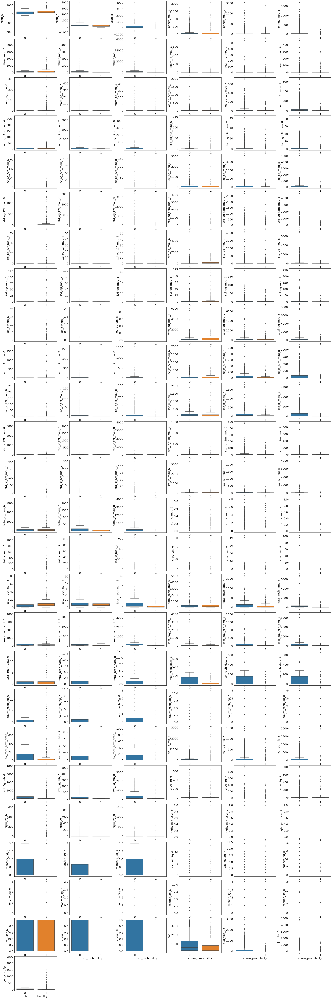

In [234]:
createBoxPlotsForNumericFeatures(telecom_lower_df)

#### Higher Outlier Dataframe Visualizations

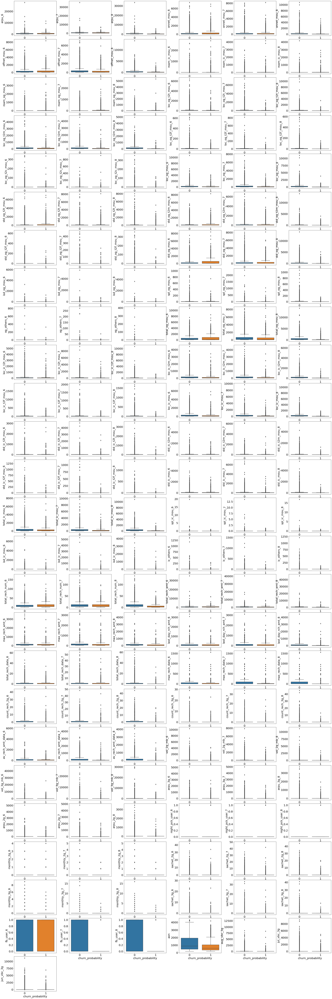

In [235]:
createBoxPlotsForNumericFeatures(telecom_higher_df)

#### Excluded Outliers Dataframe Visuals

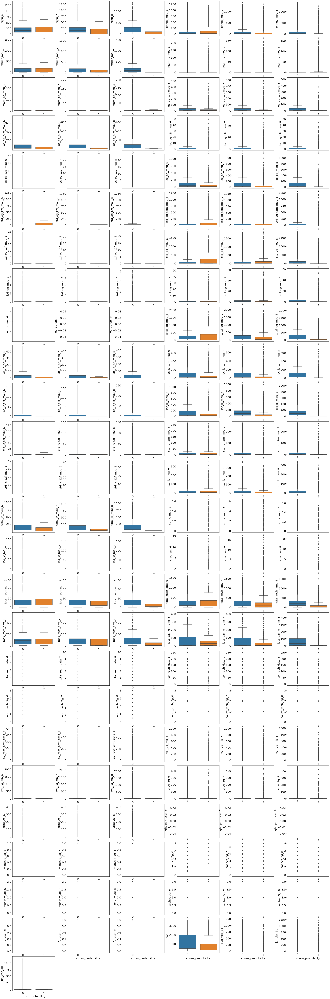

In [236]:
createBoxPlotsForNumericFeatures(telecom_df)

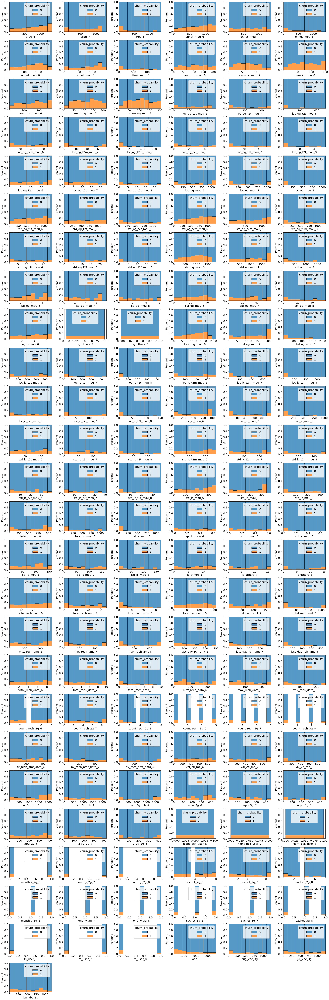

In [237]:
createHistPlotsForNumericFeatures(telecom_df)

#### Observations


*   AON (Age on network  number of days the customer is using the operator T network) - There is very clear indication from above graphs that as age of user on network is less, there is high chance of churn


*   Users who are churning are making lower local calls and higher STD calls. May be STD charges are more with this operator and so they are leaving.



*   VBC(Volume based cost  when no specific scheme is not purchased and paid as per usage) - users who doesn't have any special scheme are having more churn rate.


In [238]:
telecom_df = telecom_temp_df.copy()
## Derive new Column for toal charges that user spent - whcih is total recharge+ (average recharged amount on data*total recharge data times)
telecom_df['total_charges_6']= telecom_df['total_rech_amt_6']+(telecom_df['av_rech_amt_data_6']*telecom_df['total_rech_data_6'])
telecom_df['total_charges_7']= telecom_df['total_rech_amt_7']+(telecom_df['av_rech_amt_data_7']*telecom_df['total_rech_data_7'])
telecom_df['total_charges_8']= telecom_df['total_rech_amt_8']+(telecom_df['av_rech_amt_data_8']*telecom_df['total_rech_data_8'])

telecom_df.drop(['total_rech_amt_6','total_rech_amt_7','total_rech_amt_8','av_rech_amt_data_6','av_rech_amt_data_7','av_rech_amt_data_8','total_rech_data_6','total_rech_data_7','total_rech_data_8'],axis=1,inplace=True)

In [239]:
telecom_df['monthly_3g_6'].value_counts()

0    65990
1     3150
2      595
3      167
4       59
5       16
6       10
7        8
8        2
9        2
Name: monthly_3g_6, dtype: int64

In [240]:
# derive new colums to check how users revenue, calls, amounts are changes compared to previous months averages
telecom_df['arpu_change'] = telecom_df['arpu_8']- ((telecom_df['arpu_6']+telecom_df['arpu_7'])/2)
telecom_df['onnet_mou_change'] = telecom_df['onnet_mou_8']- ((telecom_df['onnet_mou_6']+telecom_df['onnet_mou_7'])/2)
telecom_df['offnet_mou_change'] = telecom_df['offnet_mou_8']- ((telecom_df['offnet_mou_6']+telecom_df['offnet_mou_7'])/2)
telecom_df['roam_ic_mou_6'] = telecom_df['roam_ic_mou_8']- ((telecom_df['roam_ic_mou_6']+telecom_df['roam_ic_mou_7'])/2)
telecom_df['roam_og_mou_change'] = telecom_df['roam_og_mou_8']- ((telecom_df['roam_og_mou_6']+telecom_df['roam_og_mou_7'])/2)
telecom_df['loc_og_t2t_mou_change'] = telecom_df['loc_og_t2t_mou_8']- ((telecom_df['loc_og_t2t_mou_6']+telecom_df['loc_og_t2t_mou_7'])/2)
telecom_df['loc_og_t2m_mou_change'] = telecom_df['loc_og_t2m_mou_8']- ((telecom_df['loc_og_t2m_mou_6']+telecom_df['loc_og_t2m_mou_7'])/2)
telecom_df['loc_og_t2f_mou_change'] = telecom_df['loc_og_t2f_mou_8']- ((telecom_df['loc_og_t2f_mou_6']+telecom_df['loc_og_t2f_mou_7'])/2)
telecom_df['loc_og_t2c_mou_change'] = telecom_df['loc_og_t2c_mou_8']- ((telecom_df['loc_og_t2c_mou_6']+telecom_df['loc_og_t2c_mou_7'])/2)
telecom_df['loc_og_mou_change'] = telecom_df['loc_og_mou_8']- ((telecom_df['loc_og_mou_6']+telecom_df['loc_og_mou_7'])/2)
telecom_df['std_og_t2t_mou_change'] = telecom_df['std_og_t2t_mou_8']- ((telecom_df['std_og_t2t_mou_6']+telecom_df['std_og_t2t_mou_7'])/2)
telecom_df['std_og_t2m_mou_change'] = telecom_df['std_og_t2m_mou_8']- ((telecom_df['std_og_t2m_mou_6']+telecom_df['std_og_t2m_mou_7'])/2)
telecom_df['std_og_t2f_mou_change'] = telecom_df['std_og_t2f_mou_8']- ((telecom_df['std_og_t2f_mou_6']+telecom_df['std_og_t2f_mou_7'])/2)
telecom_df['std_og_mou_change'] = telecom_df['std_og_mou_8']- ((telecom_df['std_og_mou_6']+telecom_df['std_og_mou_7'])/2)
telecom_df['isd_og_mou_change'] = telecom_df['isd_og_mou_8']- ((telecom_df['isd_og_mou_6']+telecom_df['isd_og_mou_7'])/2)
telecom_df['spl_og_mou_change'] = telecom_df['spl_og_mou_8']- ((telecom_df['spl_og_mou_6']+telecom_df['spl_og_mou_7'])/2)
telecom_df['og_others_change'] = telecom_df['og_others_8']- ((telecom_df['og_others_6']+telecom_df['og_others_7'])/2)
telecom_df['total_og_mou_change'] = telecom_df['total_og_mou_8']- ((telecom_df['total_og_mou_6']+telecom_df['total_og_mou_7'])/2)
telecom_df['loc_ic_t2t_mou_change'] = telecom_df['loc_ic_t2t_mou_8']- ((telecom_df['loc_ic_t2t_mou_6']+telecom_df['loc_ic_t2t_mou_7'])/2)
telecom_df['loc_ic_t2m_mou_change'] = telecom_df['loc_ic_t2m_mou_8']- ((telecom_df['loc_ic_t2m_mou_6']+telecom_df['loc_ic_t2m_mou_7'])/2)
telecom_df['loc_ic_t2f_mou_change'] = telecom_df['loc_ic_t2f_mou_8']- ((telecom_df['loc_ic_t2f_mou_6']+telecom_df['loc_ic_t2f_mou_7'])/2)
telecom_df['loc_ic_mou_change'] = telecom_df['loc_ic_mou_8']- ((telecom_df['loc_ic_mou_6']+telecom_df['loc_ic_mou_7'])/2)
telecom_df['std_ic_t2t_mou_change'] = telecom_df['std_ic_t2t_mou_8']- ((telecom_df['std_ic_t2t_mou_6']+telecom_df['std_ic_t2t_mou_7'])/2)
telecom_df['std_ic_t2m_mou_change'] = telecom_df['std_ic_t2m_mou_8']- ((telecom_df['std_ic_t2m_mou_6']+telecom_df['std_ic_t2m_mou_7'])/2)
telecom_df['std_ic_t2f_mou_change'] = telecom_df['std_ic_t2f_mou_8']- ((telecom_df['std_ic_t2f_mou_6']+telecom_df['std_ic_t2f_mou_7'])/2)
telecom_df['std_ic_mou_change'] = telecom_df['std_ic_mou_8']- ((telecom_df['std_ic_mou_6']+telecom_df['std_ic_mou_7'])/2)
telecom_df['total_ic_mou_change'] = telecom_df['total_ic_mou_8']- ((telecom_df['total_ic_mou_6']+telecom_df['total_ic_mou_7'])/2)
telecom_df['spl_ic_mou_change'] = telecom_df['spl_ic_mou_8']- ((telecom_df['spl_ic_mou_6']+telecom_df['spl_ic_mou_7'])/2)
telecom_df['isd_ic_mou_change'] = telecom_df['isd_ic_mou_8']- ((telecom_df['isd_ic_mou_6']+telecom_df['isd_ic_mou_7'])/2)
telecom_df['ic_others_change'] = telecom_df['ic_others_8']- ((telecom_df['ic_others_6']+telecom_df['ic_others_7'])/2)
telecom_df['total_rech_num_change'] = telecom_df['total_rech_num_8']- ((telecom_df['total_rech_num_6']+telecom_df['total_rech_num_7'])/2)
telecom_df['max_rech_amt_change'] = telecom_df['max_rech_amt_8']- ((telecom_df['max_rech_amt_6']+telecom_df['max_rech_amt_7'])/2)
telecom_df['max_rech_data_change'] = telecom_df['max_rech_data_8']- ((telecom_df['max_rech_data_6']+telecom_df['max_rech_data_7'])/2)
telecom_df['vbc_change'] = telecom_df['aug_vbc_3g']- ((telecom_df['jun_vbc_3g']+telecom_df['jul_vbc_3g'])/2)
telecom_df['total_charges_change'] = telecom_df['total_charges_8']- ((telecom_df['total_charges_6']+telecom_df['total_charges_7'])/2)


In [241]:
change_cols = [col for col in telecom_df.columns if col.endswith('_change')]

In [242]:
for change_col in change_cols:
  fig = px.histogram(data_frame=telecom_df,x=change_col,color='churn_probability',barnorm='percent',barmode='group',nbins=10)
  fig.update_layout(bargap=0.2)  
  fig.show()


#### Observations


*  Almost across all features we can see that when there is decrease in volume of calls, amount, revenue compared to previous months chances of Churning is higher.

In [243]:
##check churning rate when user in latest month doesn't have any extrac recharges
telecom_df['no_recharge'] = np.select([(((telecom_df['no_recharge_6']!=99))&(telecom_df['no_recharge_7']!=99)&(telecom_df['no_recharge_8']==99))],[0],default=1)
fig = px.histogram(data_frame=telecom_df,x='no_recharge',color='churn_probability',barnorm='percent',barmode='group')
fig.update_layout(bargap=0.2,xaxis={'tickvals':[0,1],'ticktext':['No recharge','recharge']})  
fig.show()

#### Observations



*   If user doesn't have any special rechrage like data, night pack, there are higher chances of churn


In [244]:
### Derive new column from datefields weekday and day
telecom_df['date_of_last_rech_6'] = pd.to_datetime(telecom_df['date_of_last_rech_6'] )
telecom_df['date_of_last_rech_7'] = pd.to_datetime(telecom_df['date_of_last_rech_7'] )
telecom_df['date_of_last_rech_8'] = pd.to_datetime(telecom_df['date_of_last_rech_8'] )
telecom_df['date_of_last_rech_data_6'] = pd.to_datetime(telecom_df['date_of_last_rech_data_6'] )
telecom_df['date_of_last_rech_data_7'] = pd.to_datetime(telecom_df['date_of_last_rech_data_7'] )
telecom_df['date_of_last_rech_data_8'] = pd.to_datetime(telecom_df['date_of_last_rech_data_8'] )

In [245]:
telecom_df['day_of_last_rech_6'] = telecom_df['date_of_last_rech_6'].dt.day.fillna(0)
telecom_df['day_of_last_rech_7'] = telecom_df['date_of_last_rech_7'].dt.day.fillna(0)
telecom_df['day_of_last_rech_8'] = telecom_df['date_of_last_rech_8'].dt.day.fillna(0)
telecom_df['day_of_last_rech_data_6'] = telecom_df['date_of_last_rech_data_6'].dt.day.fillna(0)
telecom_df['day_of_last_rech_data_7'] = telecom_df['date_of_last_rech_data_7'].dt.day.fillna(0)
telecom_df['day_of_last_rech_data_8'] = telecom_df['date_of_last_rech_data_8'].dt.day.fillna(0)

##Fill with 7 for users who doesn't have recharged
telecom_df['weekday_of_last_rech_6'] = telecom_df['date_of_last_rech_6'].dt.weekday.fillna(7)
telecom_df['weekday_of_last_rech_7'] = telecom_df['date_of_last_rech_7'].dt.weekday.fillna(7)
telecom_df['weekday_of_last_rech_8'] = telecom_df['date_of_last_rech_8'].dt.weekday.fillna(7)
telecom_df['weekday_of_last_rech_data_6'] = telecom_df['date_of_last_rech_data_6'].dt.weekday.fillna(7)
telecom_df['weekday_of_last_rech_data_7'] = telecom_df['date_of_last_rech_data_7'].dt.weekday.fillna(7)
telecom_df['weekday_of_last_rech_data_8'] = telecom_df['date_of_last_rech_data_8'].dt.weekday.fillna(7)



In [246]:
for col in ['day_of_last_rech_6','day_of_last_rech_7','day_of_last_rech_8','weekday_of_last_rech_6','weekday_of_last_rech_7','weekday_of_last_rech_8','weekday_of_last_rech_data_6','weekday_of_last_rech_data_7','weekday_of_last_rech_data_8']:
  fig = px.histogram(data_frame=telecom_df,x=col,color='churn_probability',barnorm='percent',barmode='group')
  fig.update_layout(bargap=0.2)  
  fig.show()


#### Observations


*   For some reason users who rechared between 1 to 15 th dates has higher churn comparted to 16 to 31. Not sure why is that?


*   People who doesn't have rechared (weekday - imputed with 7 for NAN) has higher churn rate.


In [247]:
# Lets drop these columns seems not much useful
telecom_df.drop(['date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8','date_of_last_rech_data_6','date_of_last_rech_data_7','date_of_last_rech_data_8','fb_user_6','fb_user_7','fb_user_8','day_of_last_rech_6','day_of_last_rech_7','day_of_last_rech_8','weekday_of_last_rech_6','weekday_of_last_rech_7','weekday_of_last_rech_8','weekday_of_last_rech_data_6','weekday_of_last_rech_data_7','weekday_of_last_rech_data_8'],inplace=True,axis=1)

In [248]:
  fig = px.histogram(data_frame=telecom_df,x='aon',color='churn_probability',barnorm='percent',barmode='group',nbins=8)
  fig.update_layout(bargap=0.2)  
  fig.show()

#### Observations



*   As user stays in network for longer time less chances of churn compared to new users less than 1 year.



In [249]:
telecom_df['onnet_offnet_ratio']=(telecom_df['onnet_mou_6']+telecom_df['onnet_mou_7']+telecom_df['onnet_mou_8'])/(telecom_df['onnet_mou_6']+telecom_df['onnet_mou_7']+telecom_df['onnet_mou_8']+telecom_df['offnet_mou_6']+telecom_df['offnet_mou_7']+telecom_df['offnet_mou_8'])

fig = px.histogram(data_frame=telecom_df,x='onnet_mou_6',color='churn_probability',barnorm='percent',barmode='group',nbins=8)
fig.update_layout(bargap=0.2)  
fig.show()

fig = px.histogram(data_frame=telecom_df,x='offnet_mou_6',color='churn_probability',barnorm='percent',barmode='group',nbins=8)
fig.update_layout(bargap=0.2)  
fig.show()

fig = px.histogram(data_frame=telecom_df,x='onnet_offnet_ratio',color='churn_probability',barnorm='percent',barmode='group',nbins=8)
fig.update_layout(bargap=0.2)  
fig.show()


#### Observations

*    As total mou increases, chances of churn are higher may be chrages are more.
*   Users who are making more onnet calls have higher churn rate compared to offnet calls

In [251]:
### derive new column Local to STD calls
telecom_df['local_std_mou_ratio']=(telecom_df['loc_og_mou_6']+telecom_df['loc_og_mou_7']+telecom_df['loc_og_mou_8'])/(telecom_df['std_og_mou_6']+telecom_df['std_og_mou_7']+telecom_df['std_og_mou_8']+telecom_df['loc_og_mou_6']+telecom_df['loc_og_mou_7']+telecom_df['loc_og_mou_8'])


In [ ]:
fig = px.histogram(data_frame=telecom_df,x='local_std_mou_ratio',color='churn_probability',barnorm='percent',barmode='group',nbins=8)
fig.update_layout(bargap=0.2)  
fig.show()

#### Observations

*    Users who are making more STD calls compared to Local are having higher churn rate

In [ ]:
telecom_df.info(verbose=True)

# Step 3: Data Preparation , PCA and Model Building

In [ ]:
telecom_train_df, telecom_test_df = train_test_split(telecom_df, random_state=99, train_size=0.7)